Investigating stations by zoning type

Imports and useful constants

In [2]:
import geopandas
import pandas as pd
import numpy as np
from matplotlib import pyplot as plt

import sys
sys.path.append("C:\\Users\\beezy\\git\\bluebikes_system_analysis\\code")
sys.path.append("C:\\Users\\beezy\\git\\bluebikes_system_analysis\\code\\data_handling")

# for loading station information
from data_handling.data_loading_methods import *

# useful crs constants
crs_lonlat = 'EPSG:4269'
crs_cartesian_feet = 'EPSG:2263'

# debugging
from IPython.core.debugger import Pdb;

Function definitions

Load data

In [3]:
# load data

# bluebike station data
stationdata = load_station_info()
# convert to a geodataframe
station_gdf = geopandas.GeoDataFrame(
    stationdata, geometry=geopandas.points_from_xy(stationdata['lon'], stationdata['lat']), crs=crs_lonlat)

# loading zoning subdistrict data
zoningdata = load_boston_zoning_data()

# gonna delete these entries because they're in the boston harbor
zoningdata = zoningdata.loc[ (zoningdata['Unique_Cod'] != 'Boston Harbor B-1') & 
                             (zoningdata['Unique_Cod'] != 'Boston Harbor I-2' ) ]

In [7]:
# plot a map of the zones
zoningdata.explore('Zone type', style_kwds = {'fill':True})

In [8]:
# only keep stations in boston city limits

# city limits
citylimits = load_MA_citylimits()

# filter for stations in boston
bos_limits = citylimits.loc[ citylimits['TOWN'] == 'BOSTON' ]
is_inbos = station_gdf['geometry'].map(lambda x: bos_limits['geometry'].intersects(x).any() )
stations_inbos = station_gdf.loc[is_inbos]


In [9]:
stations_inbos.explore()

In [10]:
# plot a map of the zones overlaid with the stations
ax = zoningdata.explore('Zone type', style_kwds = {'fill':True, 'stroke':False})
stations_inbos = stations_inbos.set_geometry( 'geometry' )
stations_inbos.explore( m = ax, marker_kwds = {'radius':4} )

In [11]:
# Find what zone each station is in

stations_inbos['Zone type'] = np.repeat( '', len(stations_inbos.index) )

for index, station in stations_inbos.iterrows():
    
    # find all zones intersecting this station
    intersects_station = zoningdata.intersects( station['geometry'] )
    
    # get zone type
    stations_inbos.loc[index, 'Zone type'] = zoningdata.loc[ intersects_station, 'Zone type' ].values[0]

# end for

In [12]:
stations_inbos.explore('Zone type', marker_kwds={'radius':10})

In [13]:
# count zones and stations by zone type

# get zone types
zonetypes = zoningdata['Zone type'].unique()

# for each zone type, count # of zones and stations
zonecounts_byzone = [ np.sum( zoningdata['Zone type'] == zonetype ) for zonetype in zonetypes ]
zonecounts_bystation = [ np.sum( stations_inbos['Zone type'] == zonetype ) for zonetype in zonetypes ]

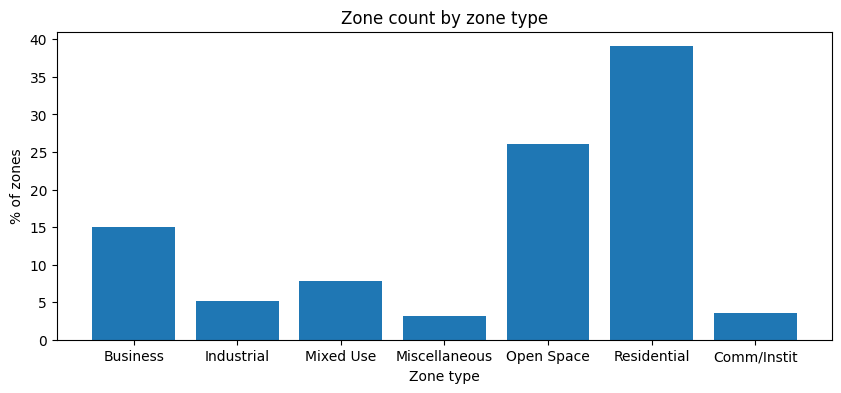

In [14]:
# bar plot of zone type counts by zone

fig, ax = plt.subplots(figsize =(10, 4))
ax.bar( x = zonetypes, 
        height = zonecounts_byzone/np.sum(zonecounts_byzone) * 100 )
 
plt.xlabel("Zone type")
plt.ylabel("% of zones")
plt.title('Zone count by zone type')
    
# Show plot
plt.show()

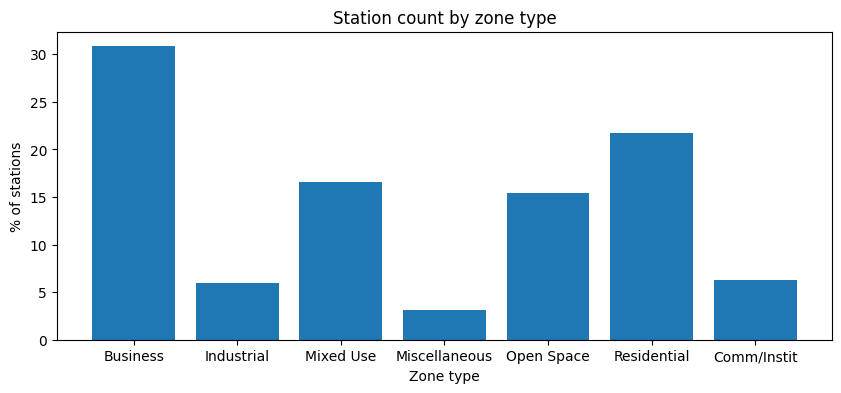

In [15]:
# bar plot of zone type counts by station

fig, ax = plt.subplots(figsize =(10, 4))
ax.bar( x = zonetypes, 
        height = zonecounts_bystation/np.sum(zonecounts_bystation) * 100 )
 
plt.xlabel("Zone type")
plt.ylabel("% of stations")
plt.title('Station count by zone type')
    
# Show plot
plt.show()

In [16]:
# calc and plot area of each zone type in perc of total area

zoneareas_bytype = [ np.sum( zoningdata.loc[ zoningdata['Zone type'] == zonetype, 'Shape__Are'] ) for zonetype in zonetypes ]

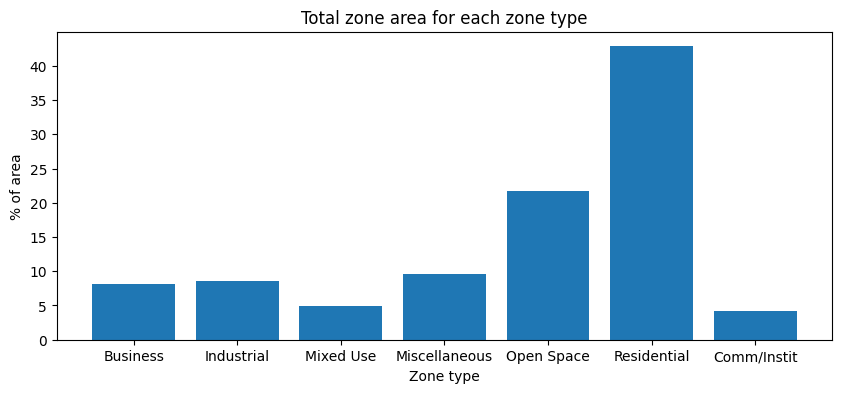

In [17]:
# bar plot of total zone area for each zone type

fig, ax = plt.subplots(figsize =(10, 4))
ax.bar( x = zonetypes, 
        height = zoneareas_bytype/np.sum(zoneareas_bytype) * 100 )
 
plt.xlabel("Zone type")
plt.ylabel("% of area")
plt.title('Total zone area for each zone type')
    
# Show plot
plt.show()

In [18]:
# load census data

# census data
tractdata = load_census_tractdata()
popdata = load_census_popdata()

# city limits
citylimits = load_MA_citylimits()

# merge census and city data together
censusdata = merge_geo_pop_data( tractdata, popdata, citylimits )
censusdata = censusdata.to_crs(crs_lonlat)

In [19]:
# calculate the averaged population density in each of the zoning areas

# need to calculate area in sqft for zoning data
zoningdata['area_sqft'] = zoningdata['geometry'].to_crs(crs_cartesian_feet).area

zoningdata['popdense'] = np.zeros( len(zoningdata.index) )

censusdata_subdiv_list = []

for index, zone in zoningdata.iterrows():
    
    # debug
    if index % 100 == 1:
        print(index)
    
    # find and get the intersecting shapes
    intersecting_tracts = censusdata.loc[ censusdata.intersects( zone['geometry'] ) ]
    intersecting_shapes = intersecting_tracts.intersection( zone['geometry'] )

    # get the area of the intersecting shapes in sqft
    intersecting_shape_areas = intersecting_shapes.to_crs(crs_cartesian_feet).area
    
    # estimate total population in that zone
    zoningdata.loc[index, 'pop'] = (intersecting_tracts['population'] * intersecting_shape_areas/intersecting_tracts['total_area']).sum()
        
# calc pop density per zone
zoningdata['popdense'] = zoningdata['pop']/zoningdata['area_sqft']
    

1
101
201
301
401
501
601
701
801
901
1001
1101
1201
1301
1401
1501
1601


In [20]:
# zoning map by population
zoningdata.explore('pop', style_kwds = {'fill':True, 'stroke':False})

In [21]:
# zoning map by pop density
zoningdata.explore('popdense', cmap='RdYlGn', style_kwds = {'fill':True, 'stroke':False})

In [22]:
# calc and plot avg and total population density of each zone type

zone_totalpopdense_bytype = [ np.sum( zoningdata.loc[ zoningdata['Zone type'] == zonetype, 'popdense'] ) for zonetype in zonetypes ]
zone_avgpopdense_bytype = [ np.mean( zoningdata.loc[ zoningdata['Zone type'] == zonetype, 'popdense'] ) for zonetype in zonetypes ]
zone_stdpopdense_bytype = [ np.std( zoningdata.loc[ zoningdata['Zone type'] == zonetype, 'popdense'] ) for zonetype in zonetypes ]
# zone_avgpopdense_bytype = [ zoningdata.loc[ zoningdata['Zone type'] == zonetype, 'popdense'].mean for zonetype in zonetypes ]

In [23]:
zone_totalpopdense_bytype

[2.061314341969484,
 0.41136595894574246,
 1.394293676592975,
 0.23750709738946216,
 3.609059741796702,
 5.285170735006325,
 0.6180017430189437]

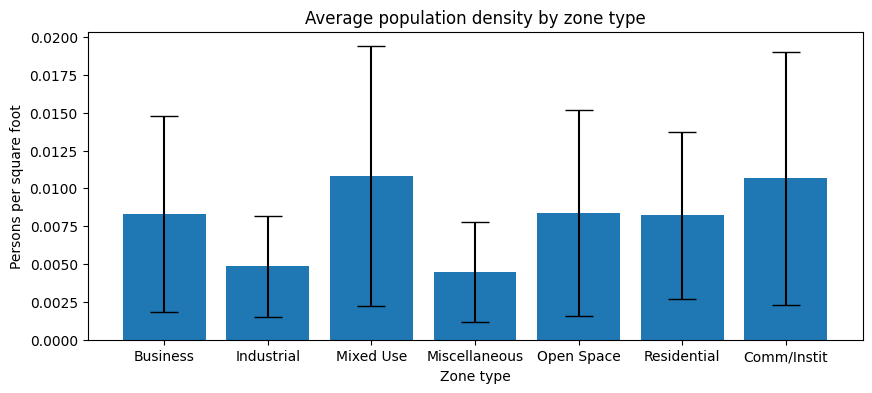

In [24]:
# bar plot of average population density by zone type

fig, ax = plt.subplots(figsize =(10, 4))
ax.bar( x = zonetypes, 
        height = zone_avgpopdense_bytype,
      yerr = zone_stdpopdense_bytype, capsize = 10)
 
plt.xlabel("Zone type")
plt.ylabel("Persons per square foot")
plt.title('Average population density by zone type')
    
# Show plot
plt.show()

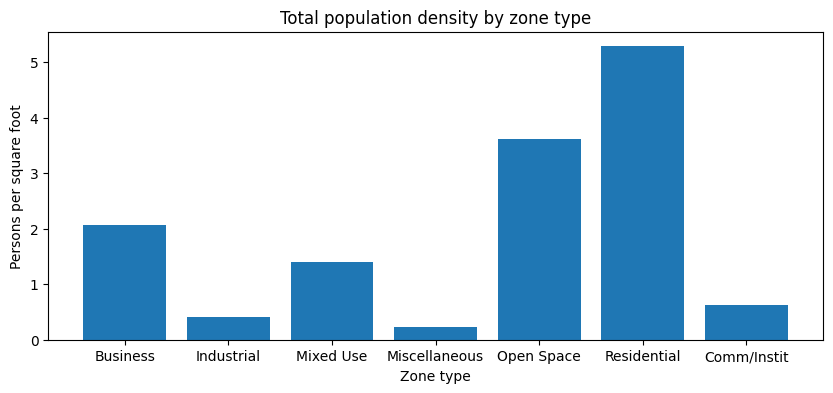

In [25]:
# bar plot of total population density by zone type

fig, ax = plt.subplots(figsize =(10, 4))
ax.bar( x = zonetypes, 
        height = zone_totalpopdense_bytype )
 
plt.xlabel("Zone type")
plt.ylabel("Persons per square foot")
plt.title('Total population density by zone type')
    
# Show plot
plt.show()

In [26]:
# weighted average of population density

zone_weightedavgpopdense_bytype = [ np.sum( zoningdata.loc[ zoningdata['Zone type'] == zonetype, 'popdense'] )/np.sum( zoningdata.loc[ zoningdata['Zone type'] == zonetype, 'area_sqft'] ) for zonetype in zonetypes ]

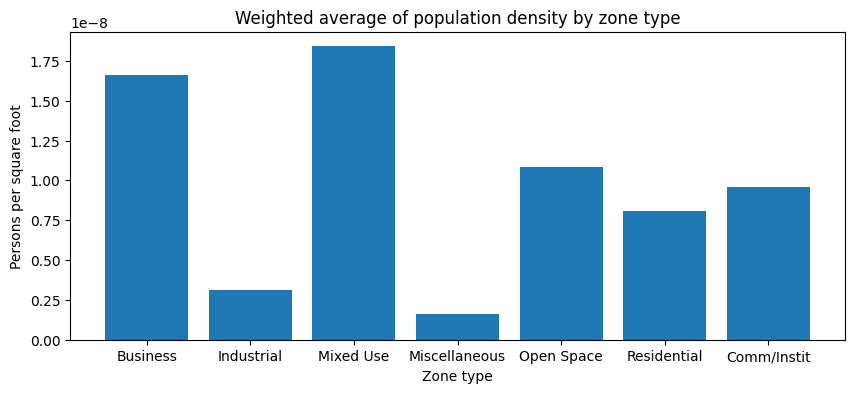

In [27]:
# bar plot of weighted avg (by area size) of population density by zone type

fig, ax = plt.subplots(figsize =(10, 4))
ax.bar( x = zonetypes, 
        height = zone_weightedavgpopdense_bytype )
 
plt.xlabel("Zone type")
plt.ylabel("Persons per square foot")
plt.title('Weighted average of population density by zone type')
    
# Show plot
plt.show()

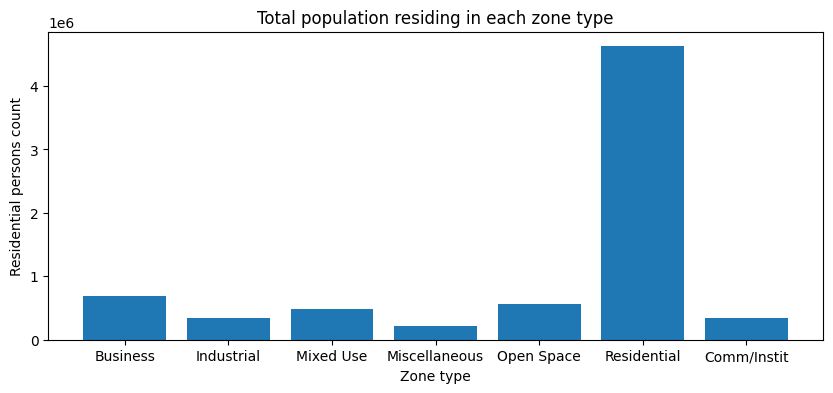

In [32]:
# calc and plot avg and total population of each zone type

zone_totalpop_bytype = [ np.sum( zoningdata.loc[ zoningdata['Zone type'] == zonetype, 'pop'] ) for zonetype in zonetypes ]
zone_avgpop_bytype = [ np.mean( zoningdata.loc[ zoningdata['Zone type'] == zonetype, 'pop'] ) for zonetype in zonetypes ]
zone_stdpop_bytype = [ np.std( zoningdata.loc[ zoningdata['Zone type'] == zonetype, 'pop'] ) for zonetype in zonetypes ]

# bar plot of total population by zone type
fig, ax = plt.subplots(figsize =(10, 4))
ax.bar( x = zonetypes, 
        height = zone_totalpop_bytype )
 
plt.xlabel("Zone type")
plt.ylabel("Residential persons count")
plt.title('Total population residing in each zone type')
    
# Show plot
plt.show()

Here I want to draw a 5 min walk radius around each station and count the types of zones each intersects

In [33]:
# drawing the stations as circles with radius given by a walking distance

# convert to feet
stations_inbos = stations_inbos.to_crs(crs=crs_cartesian_feet)

# calc distance
walktime = 5 # minutes
mph = 3.25
fph = mph * 5280 # feet per hour
fpm = fph / 60 # feet per minute
walkradius = walktime * fpm
# walkradius

# buffer
stations_inbos['walkable_region'] = stations_inbos.buffer(walkradius)

# station_gdf['walkable_region'].plot()
stations_inbos = stations_inbos.set_geometry('walkable_region')

# re-convert CRS back to lon/lat
stations_inbos = stations_inbos.to_crs(crs=crs_lonlat)

In [34]:
# combine all zones of each type into one big shape each
zones_shapecombined = {}

for zonetype in zonetypes:
    zones_shapecombined[zonetype] = zoningdata.loc[zoningdata['Zone type'] == zonetype].dissolve()


In [35]:
# count number of stations' walking radius intersecting each zone type

# counts each time a station intersects a zone type
walkrad_zone_intersect_counts = dict(zip(zonetypes, np.zeros(len(zonetypes))))
walkrad_zone_bike_counts = dict(zip(zonetypes, np.zeros(len(zonetypes))))

# for each station, count each time it intersects each zone type
# also count the number of bikes intersecting each zone type
for index, station in stations_inbos.iterrows():
#     print('station' + str(index))
    for zonetype in zonetypes:
        # if intersects, add to counts
        if zones_shapecombined[zonetype].intersects( station['walkable_region'] )[0]:
            walkrad_zone_intersect_counts[zonetype] = walkrad_zone_intersect_counts[zonetype] + 1
            walkrad_zone_bike_counts[zonetype] = walkrad_zone_bike_counts[zonetype] + station['capacity']
        
# walkrad_zone_bike_counts

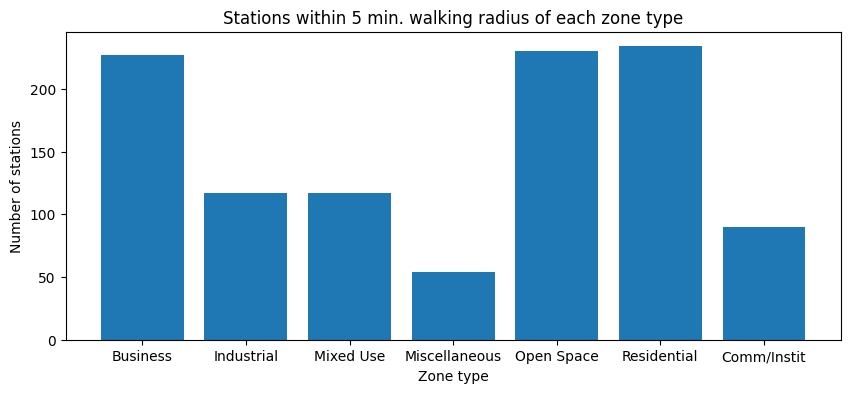

In [36]:
# bar plot of num stations intersecting each zone type
fig, ax = plt.subplots(figsize =(10, 4))
ax.bar( x = list(walkrad_zone_intersect_counts.keys()), 
        height = list(walkrad_zone_intersect_counts.values()) )
 
plt.xlabel("Zone type")
plt.ylabel("Number of stations")
plt.title('Stations within ' + str(walktime) + ' min. walking radius of each zone type')
    
# Show plot
plt.show()

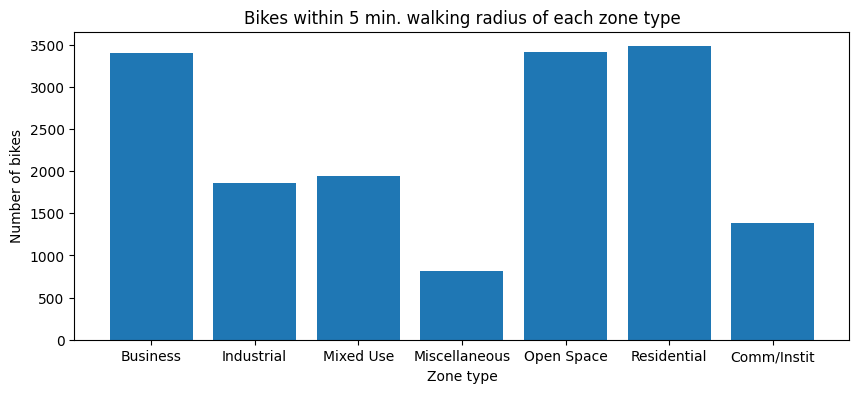

In [37]:
# bar plot of num bikes intersecting each zone type
fig, ax = plt.subplots(figsize =(10, 4))
ax.bar( x = list(walkrad_zone_bike_counts.keys()), 
        height = list(walkrad_zone_bike_counts.values()) )
 
plt.xlabel("Zone type")
plt.ylabel("Number of bikes")
plt.title('Bikes within ' + str(walktime) + ' min. walking radius of each zone type')
    
# Show plot
plt.show()

In [38]:
# plot a map of the zones overlaid with the station and their walk radii
ax = zoningdata.explore('Zone type', style_kwds = {'fill':True, 'stroke':False})
stations_inbos.explore( m = ax, style_kwds = {'fill':False} )